## Import Modules

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
import tensorflow_datasets as tfds
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')

## Load the files

In [ ]:
# Import the zipfile library
import zipfile

# Specify the path to the zip file
zip_file_path = "/content/drive/MyDrive/archive.zip"

# Open the zip file
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
  # Extract all the files in the zip file
  zip_ref.extractall("/content")

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip /content/drive/MyDrive/data-2.zip

In [ ]:
BASE_DIR = '/content/Multi_Label_dataset/Images'

In [ ]:
# load complete image paths to the list
image_paths = []
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR, image_name)
    image_paths.append(image_path)

In [ ]:
image_paths[:5]

['/content/Multi_Label_dataset/Images/tt0137338.jpg',
 '/content/Multi_Label_dataset/Images/tt1872181.jpg',
 '/content/Multi_Label_dataset/Images/tt0094910.jpg',
 '/content/Multi_Label_dataset/Images/tt0407263.jpg',
 '/content/Multi_Label_dataset/Images/tt0104694.jpg']

In [ ]:
# remove unnecessary file
image_paths.remove('/content/data/data')

ValueError: list.remove(x): x not in list

In [ ]:
# import os

# # Replace 'folder_path' with the path to the folder you want to delete files from
# folder_path = '/content/imp'

# # Get a list of all files in the folder
# files = os.listdir(folder_path)

# # Iterate over the files and delete them
# for file in files:
#   file_path = os.path.join(folder_path, file)
#   os.remove(file_path)

In [ ]:
# import os
# import shutil

# # Define the source and destination folders
# source_folder = "/content/SampleMoviePosters/SampleMoviePosters"  # Adjust this path
# destination_folder = "/content/Multi_Label_dataset/Images"  # Adjust this path

# # Ensure the destination folder exists
# os.makedirs(destination_folder, exist_ok=True)

# # Loop through all files in the source folder
# for file_name in os.listdir(source_folder):
#     source_file = os.path.join(source_folder, file_name)
#     destination_file = os.path.join(destination_folder, file_name)

#     # Check if this is a file (and not a directory)
#     if os.path.isfile(source_file):
#         # If a file with the same name exists in the destination folder, you can decide to:
#         # a) Skip and keep the existing file (do nothing)
#         # b) Overwrite the existing file with the new one
#         # Here, we choose option b) Overwrite:
#         if os.path.exists(destination_file):
#             print(f"Overwriting: {destination_file}")
#         else:
#             print(f"Copying: {destination_file}")

#         # Copy the file from the source folder to the destination folder
#         shutil.copy2(source_file, destination_folder)

# print("Merging completed.")


In [ ]:
# import os
# import shutil
# import random

# # Source folder containing the images
# source_folder = '/content/SampleMoviePosters/SampleMoviePosters'

# # Destination folder to copy the images to
# destination_folder = '/content/imp'

# # Get a list of all the files in the source folder
# files = os.listdir(source_folder)

# # Select 2000 random files
# random_files = random.sample(files, 10000)

# # Copy the random files to the destination folder
# for file in random_files:
#     src_path = os.path.join(source_folder, file)
#     dst_path = os.path.join(destination_folder, file)
#     shutil.copyfile(src_path, dst_path)

In [ ]:
len(image_paths)

8864

## Visualize the Image Dataset

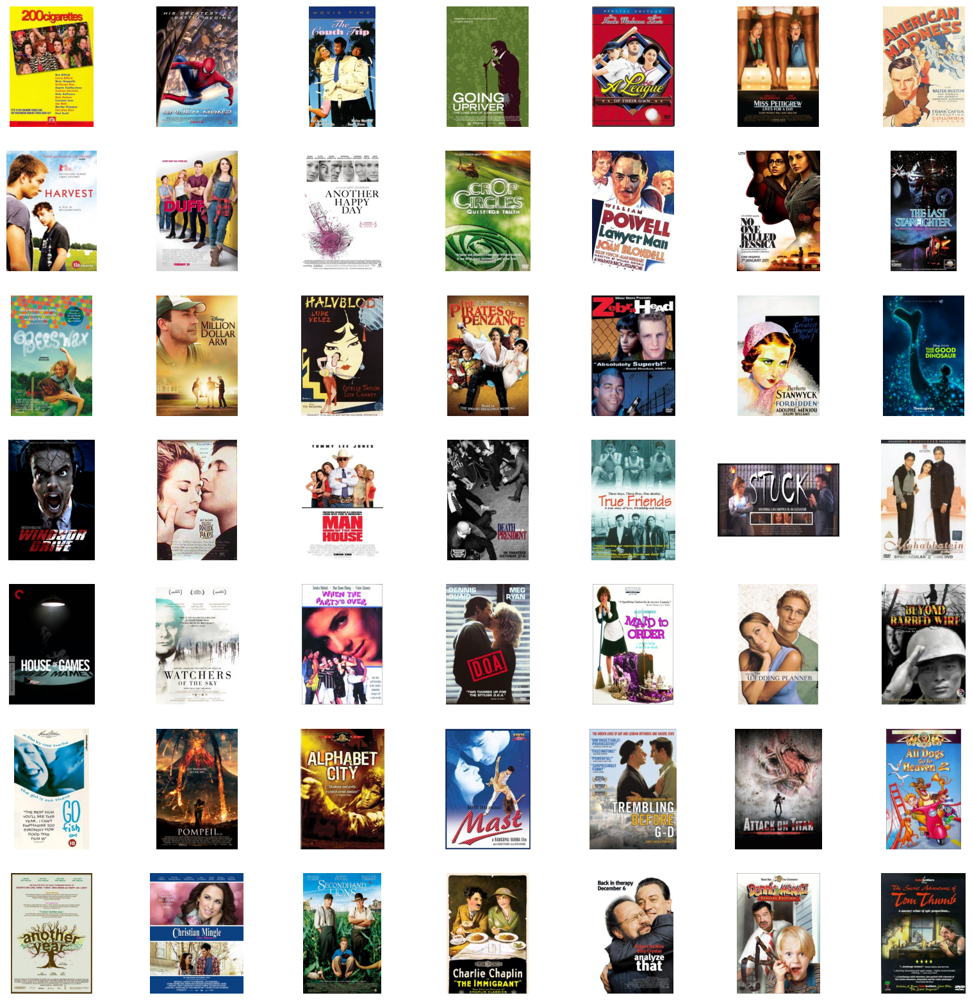

In [ ]:
# to display grid of images (7x7)
plt.figure(figsize=(20, 20))
temp_images = image_paths[:49]
index = 1

for image_path in temp_images:
    plt.subplot(7, 7, index)
    # load the image
    img = load_img(image_path)
    # convert to numpy array
    img = np.array(img)
    # show the image
    plt.imshow(img)
    plt.axis('off')
    # increment the index for next image
    index += 1



In [ ]:
# img.shape

## Preprocess Images

In [ ]:
from tensorflow.keras.preprocessing.image import load_img

# load the image and convert to numpy array
train_images = [np.array(load_img(path).resize((64, 64))) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/8864 [00:00<?, ?it/s]

In [ ]:
train_images[0].shape

(64, 64, 3)

In [ ]:
# reshape the array
train_images = train_images.reshape(train_images.shape[0], 64, 64, 3).astype('float32')

In [ ]:
# normalize the images
train_images = (train_images - 127.5) / 127.5

In [ ]:
train_images[0]

array([[[-0.9924029 , -0.9928335 , -1.0075356 ],
        [-0.9924029 , -0.9928335 , -1.0075356 ],
        [-0.9924029 , -0.9928335 , -1.0075356 ],
        ...,
        [-0.99258745, -0.992895  , -1.0075971 ],
        [-0.9924644 , -0.9928335 , -1.0074741 ],
        [-0.99252594, -0.99301803, -1.0070435 ]],

       [[-0.9924029 , -0.9928335 , -1.0075356 ],
        [-0.9924029 , -0.9928335 , -1.0075356 ],
        [-0.9924029 , -0.9928335 , -1.0075356 ],
        ...,
        [-0.99258745, -0.99326414, -1.0074126 ],
        [-0.99252594, -0.99326414, -1.0072895 ],
        [-0.99258745, -0.99326414, -1.0075356 ]],

       [[-0.9924029 , -0.9928335 , -1.0075356 ],
        [-0.9924029 , -0.9928335 , -1.0075356 ],
        [-0.9924029 , -0.9928335 , -1.0075356 ],
        ...,
        [-0.99258745, -0.99338716, -1.0074741 ],
        [-0.9927105 , -0.9935102 , -1.0075356 ],
        [-0.99264896, -0.9934487 , -1.0074741 ]],

       ...,

       [[-0.99387926, -1.0067974 , -1.0062438 ],
        [-0

## Create Generator & Discriminator Models

In [ ]:
# latent dimension for random noise
LATENT_DIM = 100
# weight initializer
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# no. of channels of the image
CHANNELS = 3 # for gray scale, keep it as 1

### Generator Model

Generator Model will create new images similar to training data from random noise

In [ ]:
model = Sequential(name='generator')

# 1d random noise
model.add(layers.Dense(8 * 8 * 512, input_dim=LATENT_DIM))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# convert 1d to 3d
model.add(layers.Reshape((8, 8, 512)))

# upsample to 16x16
model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 32x32
model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 64x64
model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh'))

generator = model
generator.summary()

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_2 (Dense)             (None, 32768)             3309568   
                                                                 
 re_lu_4 (ReLU)              (None, 32768)             0         
                                                                 
 reshape_1 (Reshape)         (None, 8, 8, 512)         0         
                                                                 
 conv2d_transpose_3 (Conv2D  (None, 16, 16, 256)       2097408   
 Transpose)                                                      
                                                                 
 re_lu_5 (ReLU)              (None, 16, 16, 256)       0         
                                                                 
 conv2d_transpose_4 (Conv2D  (None, 32, 32, 128)       524416    
 Transpose)                                              

### Discriminator Model

Discriminator model will classify the image from the generator to check whether it real (or) fake images.

In [ ]:
model = Sequential(name='discriminator')
input_shape = (64, 64, 3)
alpha = 0.2

# create conv layers
model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

# output class
model.add(layers.Dense(1, activation='sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_5 (Conv2D)           (None, 32, 32, 64)        3136      
                                                                 
 batch_normalization_3 (Bat  (None, 32, 32, 64)        256       
 chNormalization)                                                
                                                                 
 leaky_re_lu_3 (LeakyReLU)   (None, 32, 32, 64)        0         
                                                                 
 conv2d_6 (Conv2D)           (None, 16, 16, 128)       131200    
                                                                 
 batch_normalization_4 (Bat  (None, 16, 16, 128)       512       
 chNormalization)                                                
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 16, 16, 128)     

## Create DCGAN

In [ ]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')

    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]

    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn

    def train_step(self, real_images):
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))

        # train the discriminator with real (1) and fake (0) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)

            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)

            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2

        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))


        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)

        # compute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))

        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

In [ ]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        # create random noise for generating images
        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        # generate the image from noise
        g_img = self.model.generator(self.noise)
        # denormalize the image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()

        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        # plt.savefig('epoch_{:03d}.png'.format(epoch))
        plt.show()

    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

In [ ]:
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

In [ ]:
D_LR = 0.0001
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())

Epoch 1/60
  6/277 [..............................] - ETA: 22s - d_loss: 1.6875 - g_loss: 0.2680

277/277 [==============================] - ETA: 0s - d_loss: 0.3443 - g_loss: 2.7422

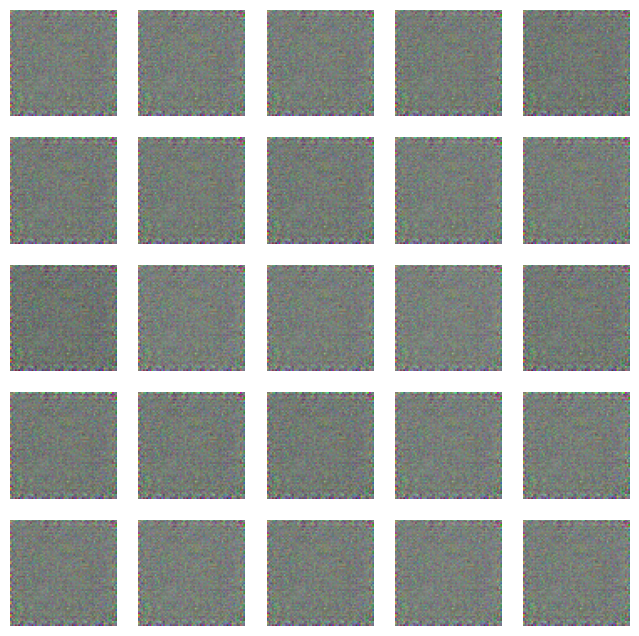

277/277 [==============================] - 24s 72ms/step - d_loss: 0.3443 - g_loss: 2.7422
Epoch 2/60
277/277 [==============================] - ETA: 0s - d_loss: -0.4487 - g_loss: 4.7887

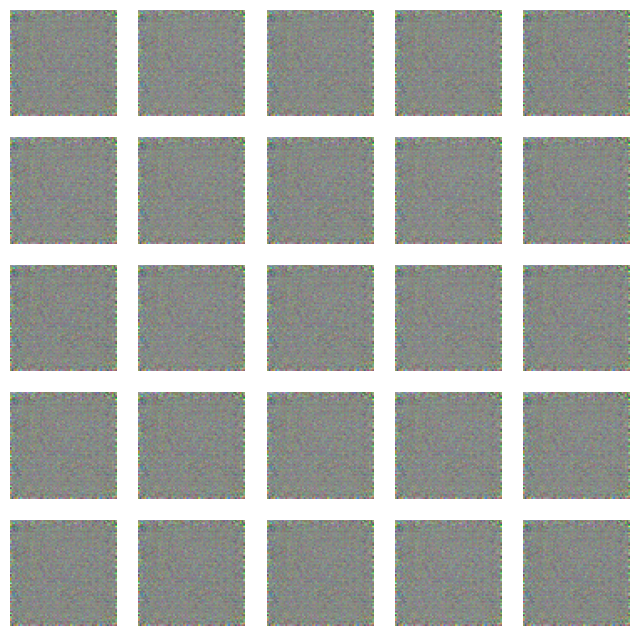

277/277 [==============================] - 19s 70ms/step - d_loss: -0.4487 - g_loss: 4.7887
Epoch 3/60
277/277 [==============================] - ETA: 0s - d_loss: -0.8743 - g_loss: 5.9413

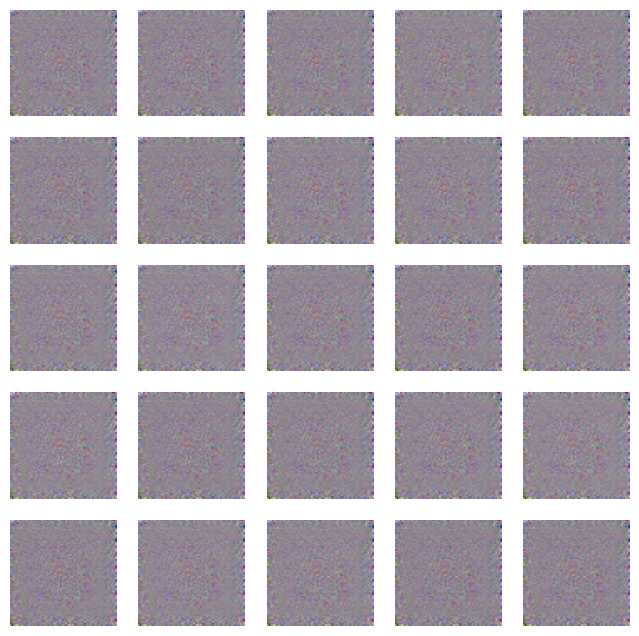

277/277 [==============================] - 19s 70ms/step - d_loss: -0.8743 - g_loss: 5.9413
Epoch 4/60
277/277 [==============================] - ETA: 0s - d_loss: -1.4300 - g_loss: 7.4858

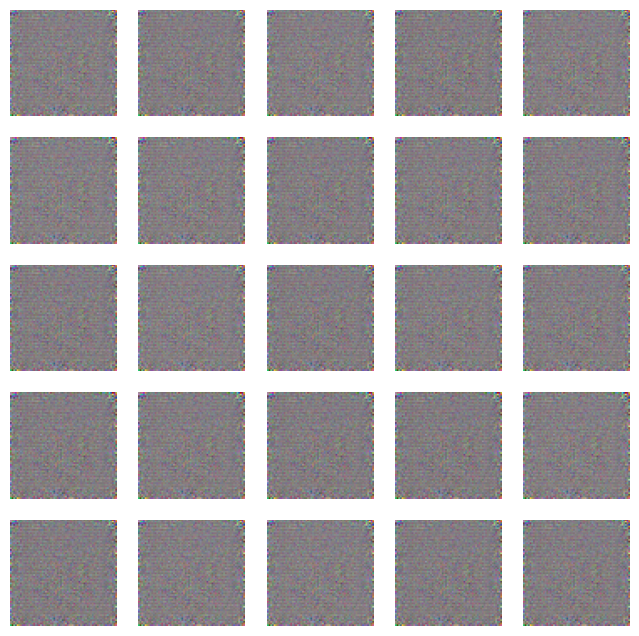

277/277 [==============================] - 19s 69ms/step - d_loss: -1.4300 - g_loss: 7.4858
Epoch 5/60
277/277 [==============================] - ETA: 0s - d_loss: -2.1659 - g_loss: 8.6987

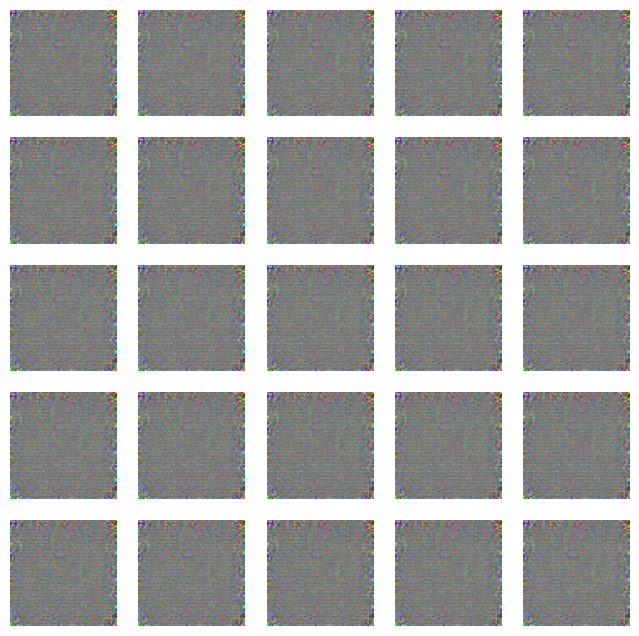

277/277 [==============================] - 19s 68ms/step - d_loss: -2.1659 - g_loss: 8.6987
Epoch 6/60
277/277 [==============================] - ETA: 0s - d_loss: -1.4568 - g_loss: 9.1118

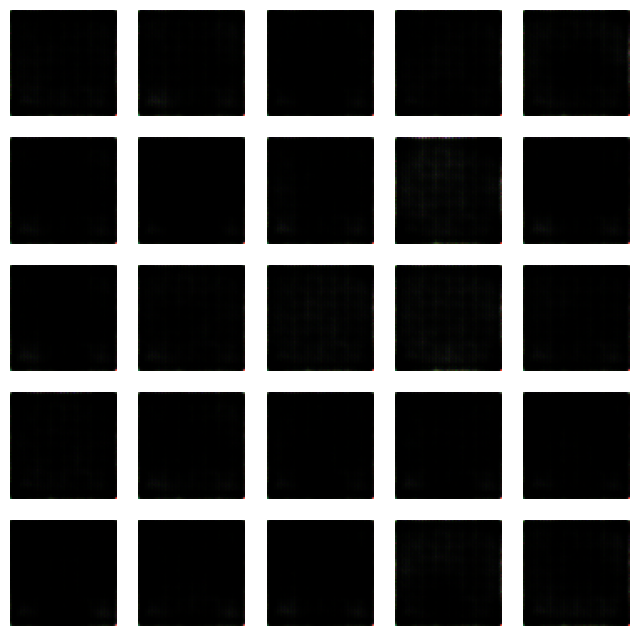

277/277 [==============================] - 19s 70ms/step - d_loss: -1.4568 - g_loss: 9.1118
Epoch 7/60
277/277 [==============================] - ETA: 0s - d_loss: 1.0482 - g_loss: 1.3134

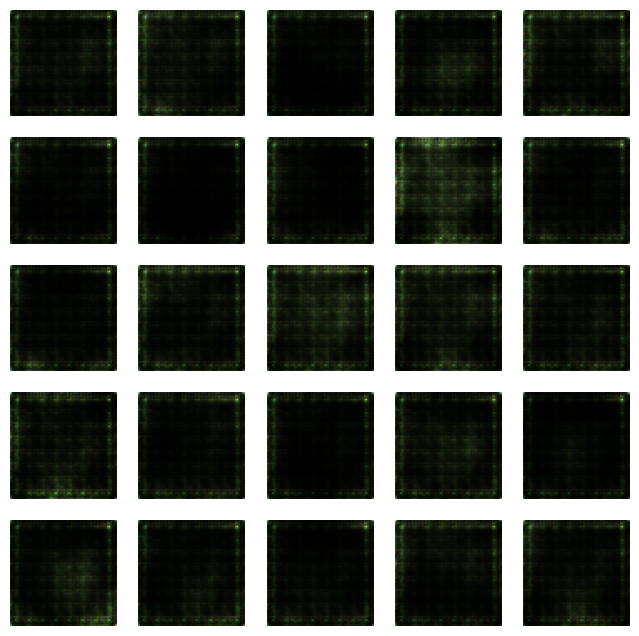

277/277 [==============================] - 20s 71ms/step - d_loss: 1.0482 - g_loss: 1.3134
Epoch 8/60
277/277 [==============================] - ETA: 0s - d_loss: 0.9781 - g_loss: 1.0779

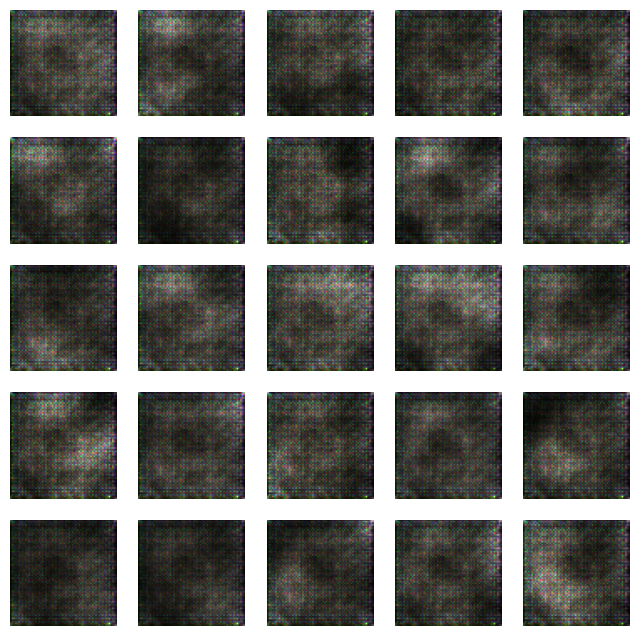

277/277 [==============================] - 19s 69ms/step - d_loss: 0.9781 - g_loss: 1.0779
Epoch 9/60
277/277 [==============================] - ETA: 0s - d_loss: 0.9326 - g_loss: 0.9440

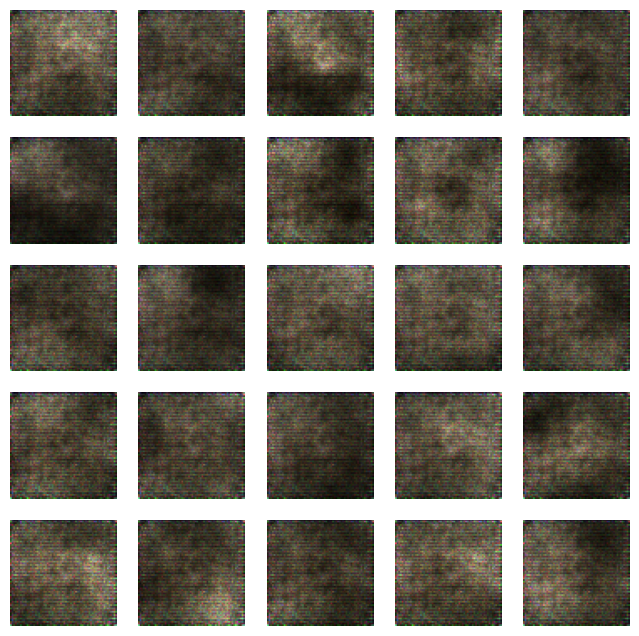

277/277 [==============================] - 21s 75ms/step - d_loss: 0.9326 - g_loss: 0.9440
Epoch 10/60
277/277 [==============================] - ETA: 0s - d_loss: 0.8687 - g_loss: 0.8800

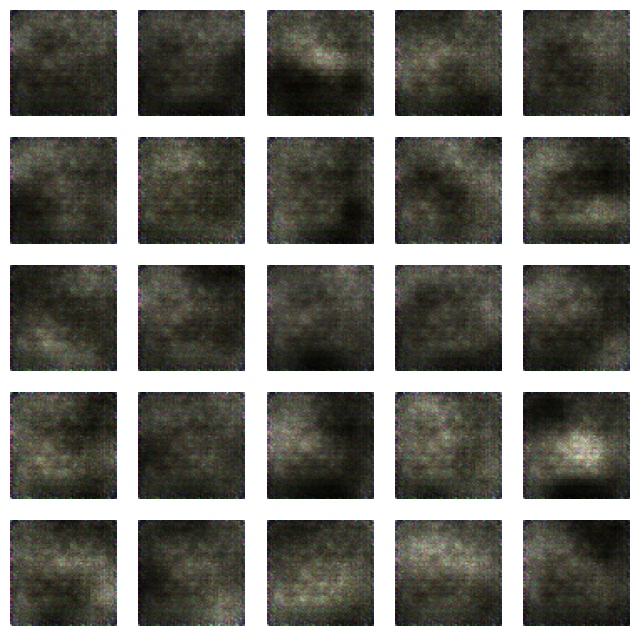

277/277 [==============================] - 20s 72ms/step - d_loss: 0.8687 - g_loss: 0.8800
Epoch 11/60
277/277 [==============================] - ETA: 0s - d_loss: 0.8193 - g_loss: 0.8476

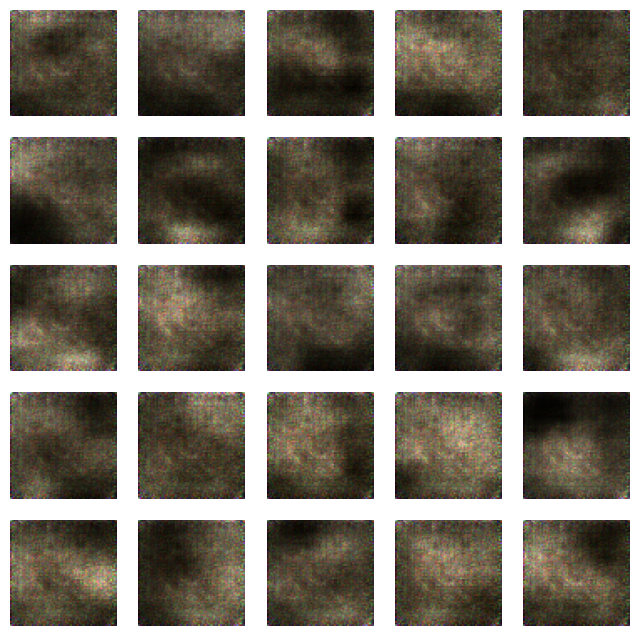

277/277 [==============================] - 20s 71ms/step - d_loss: 0.8193 - g_loss: 0.8476
Epoch 12/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7743 - g_loss: 0.8965

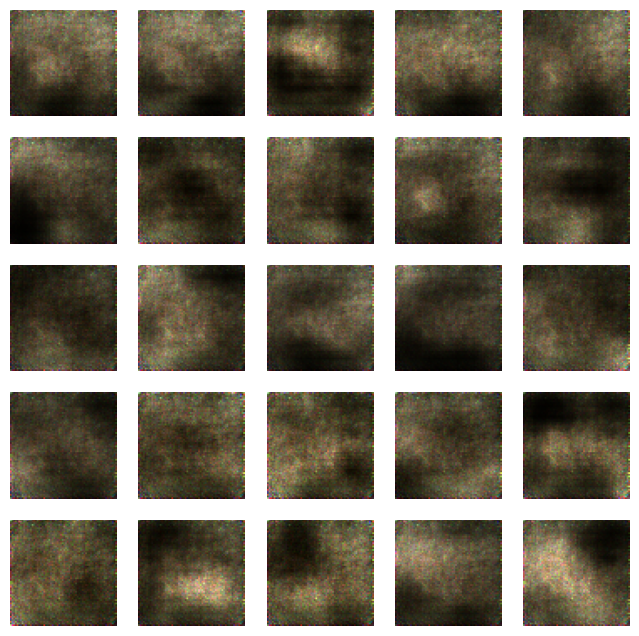

277/277 [==============================] - 22s 79ms/step - d_loss: 0.7743 - g_loss: 0.8965
Epoch 13/60
277/277 [==============================] - ETA: 0s - d_loss: 0.6712 - g_loss: 1.1509

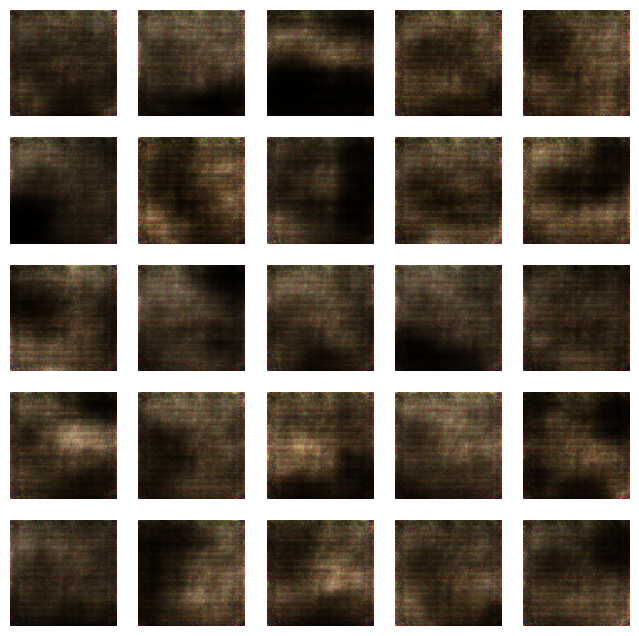

277/277 [==============================] - 20s 73ms/step - d_loss: 0.6712 - g_loss: 1.1509
Epoch 14/60
277/277 [==============================] - ETA: 0s - d_loss: 0.6525 - g_loss: 1.2530

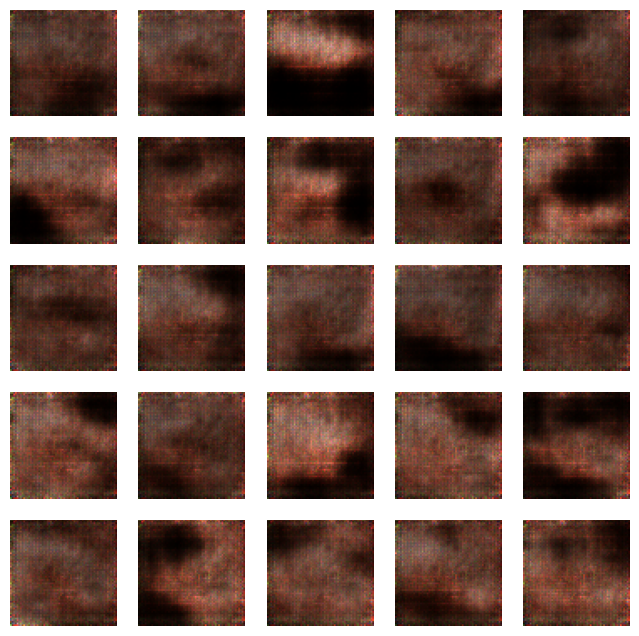

277/277 [==============================] - 20s 73ms/step - d_loss: 0.6525 - g_loss: 1.2530
Epoch 15/60
277/277 [==============================] - ETA: 0s - d_loss: 0.6833 - g_loss: 1.1977

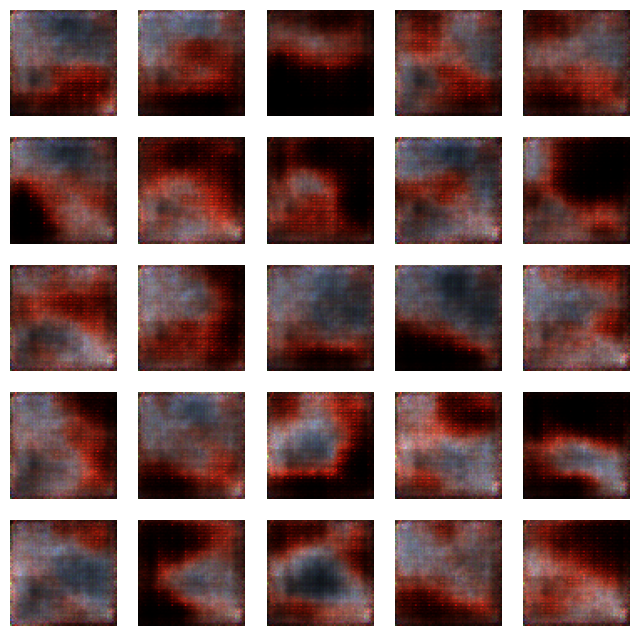

277/277 [==============================] - 20s 72ms/step - d_loss: 0.6833 - g_loss: 1.1977
Epoch 16/60
277/277 [==============================] - ETA: 0s - d_loss: 0.6541 - g_loss: 1.2098

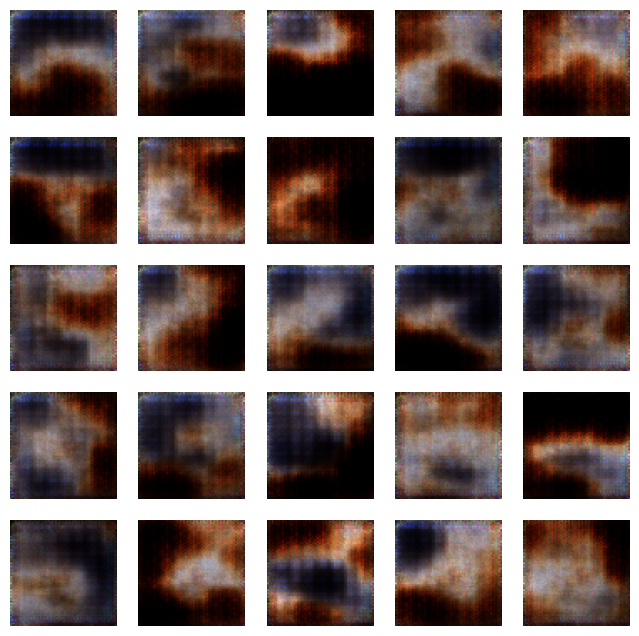

277/277 [==============================] - 20s 71ms/step - d_loss: 0.6541 - g_loss: 1.2098
Epoch 17/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7046 - g_loss: 1.0530

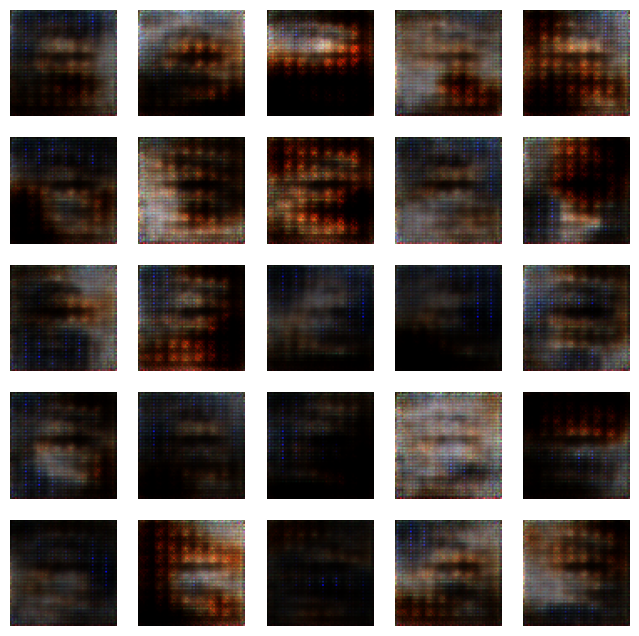

277/277 [==============================] - 20s 72ms/step - d_loss: 0.7046 - g_loss: 1.0530
Epoch 18/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7352 - g_loss: 0.9959

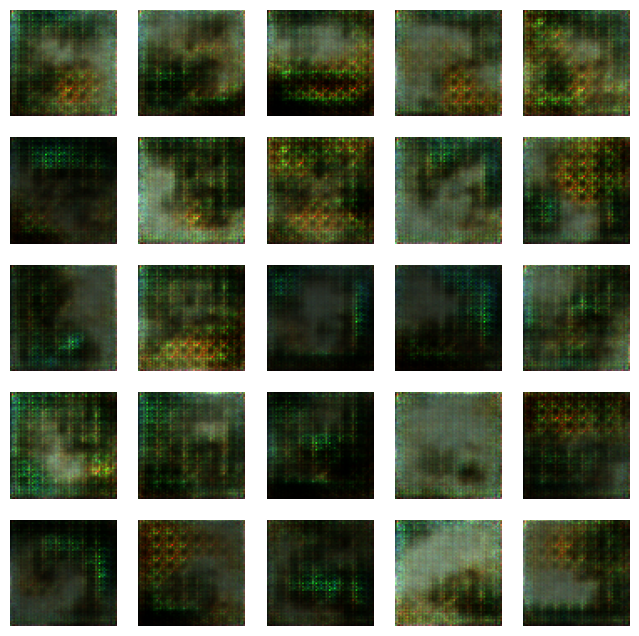

277/277 [==============================] - 20s 72ms/step - d_loss: 0.7352 - g_loss: 0.9959
Epoch 19/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7598 - g_loss: 0.8848

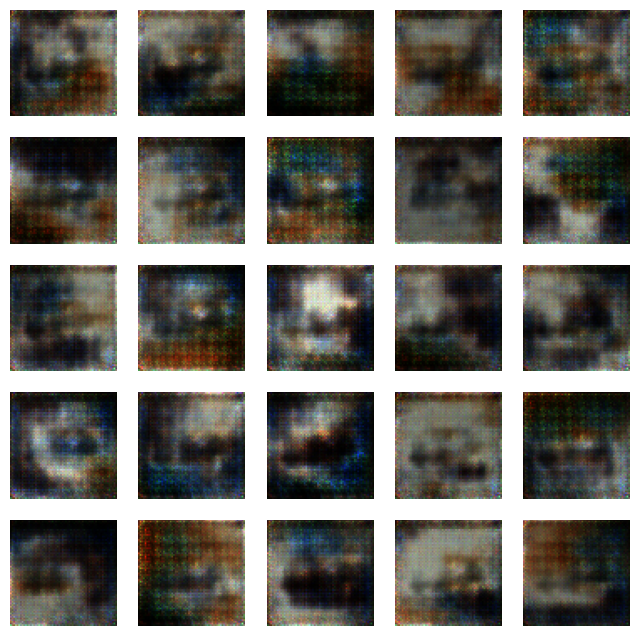

277/277 [==============================] - 20s 71ms/step - d_loss: 0.7598 - g_loss: 0.8848
Epoch 20/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7553 - g_loss: 0.8606

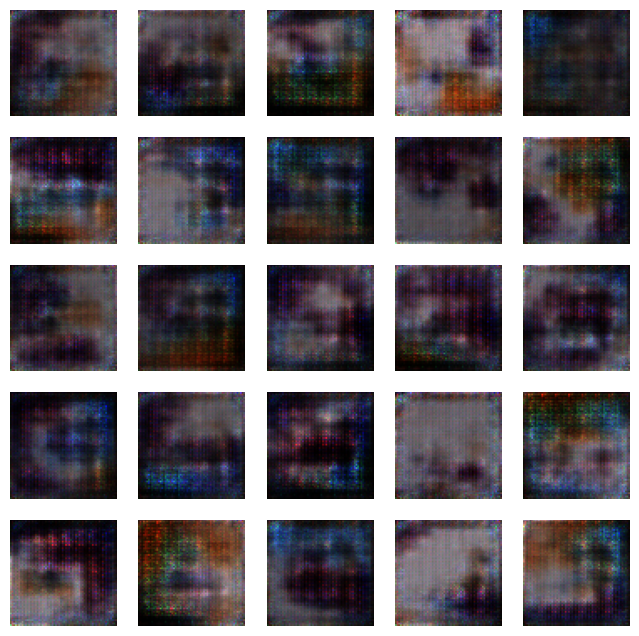

277/277 [==============================] - 20s 73ms/step - d_loss: 0.7553 - g_loss: 0.8606
Epoch 21/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7479 - g_loss: 0.8155

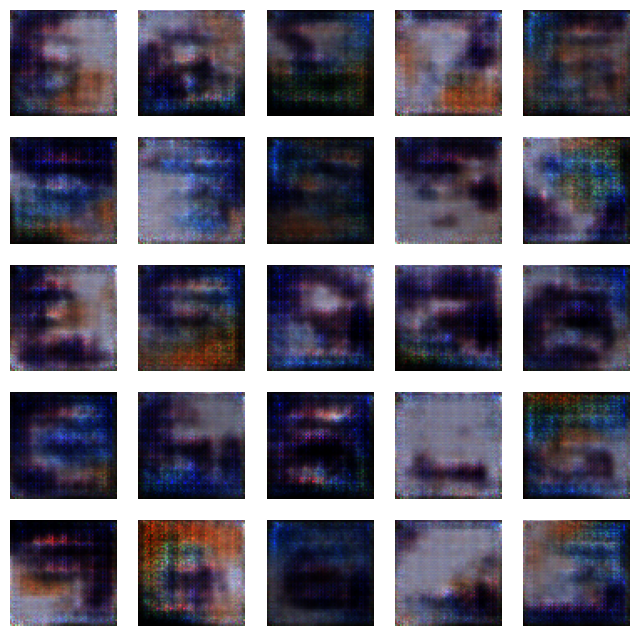

277/277 [==============================] - 20s 73ms/step - d_loss: 0.7479 - g_loss: 0.8155
Epoch 22/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7456 - g_loss: 0.8200

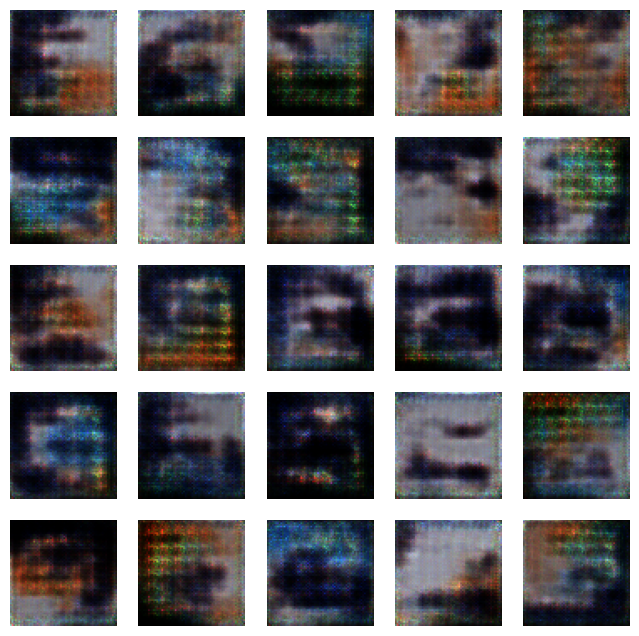

277/277 [==============================] - 20s 72ms/step - d_loss: 0.7456 - g_loss: 0.8200
Epoch 23/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7497 - g_loss: 0.7508

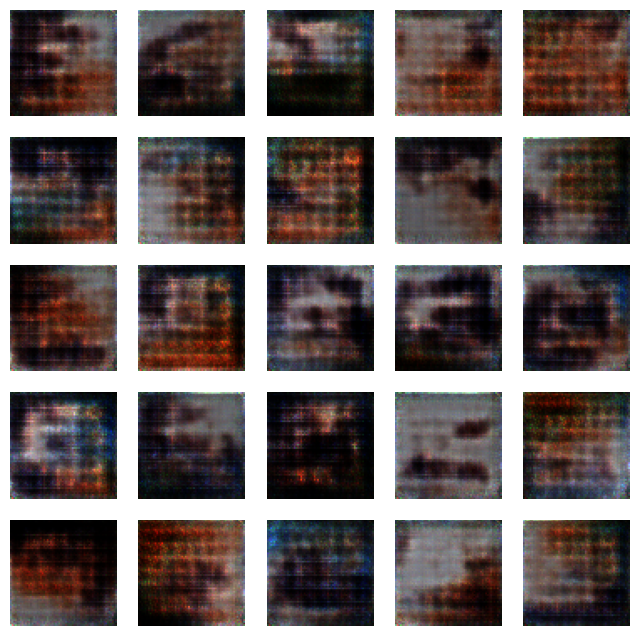

277/277 [==============================] - 20s 73ms/step - d_loss: 0.7497 - g_loss: 0.7508
Epoch 24/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7426 - g_loss: 0.7372

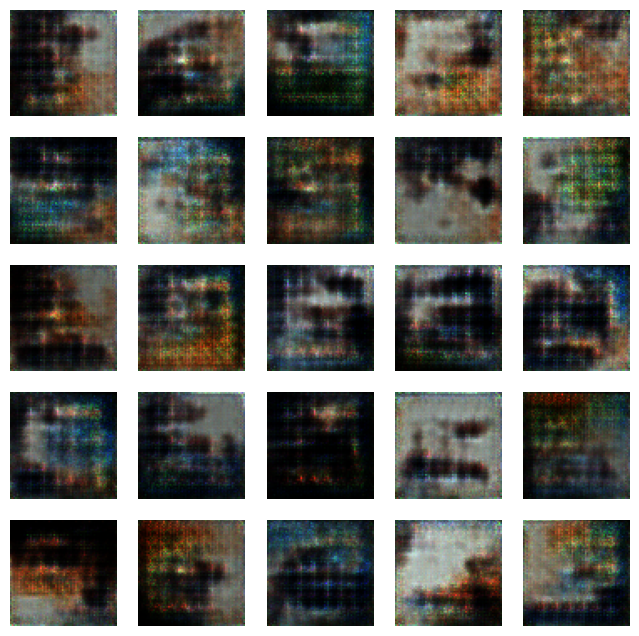

277/277 [==============================] - 20s 73ms/step - d_loss: 0.7426 - g_loss: 0.7372
Epoch 25/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7375 - g_loss: 0.7312

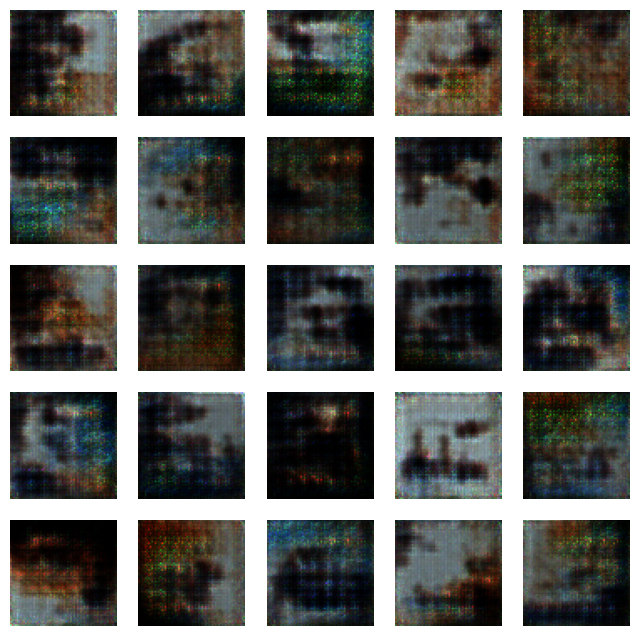

277/277 [==============================] - 20s 72ms/step - d_loss: 0.7375 - g_loss: 0.7312
Epoch 26/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7282 - g_loss: 0.7351

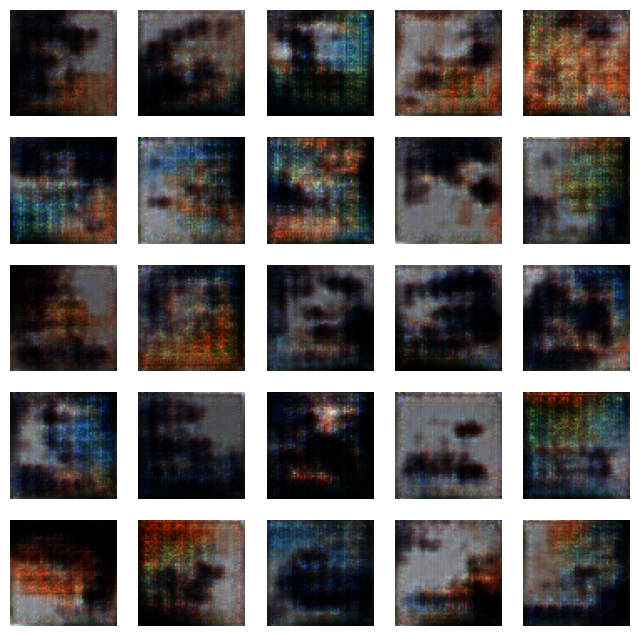

277/277 [==============================] - 20s 73ms/step - d_loss: 0.7282 - g_loss: 0.7351
Epoch 27/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7304 - g_loss: 0.7317

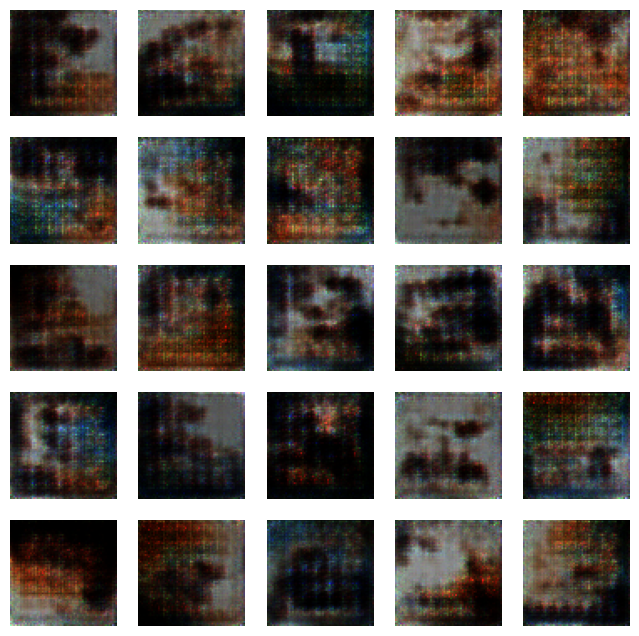

277/277 [==============================] - 20s 72ms/step - d_loss: 0.7304 - g_loss: 0.7317
Epoch 28/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7263 - g_loss: 0.7410

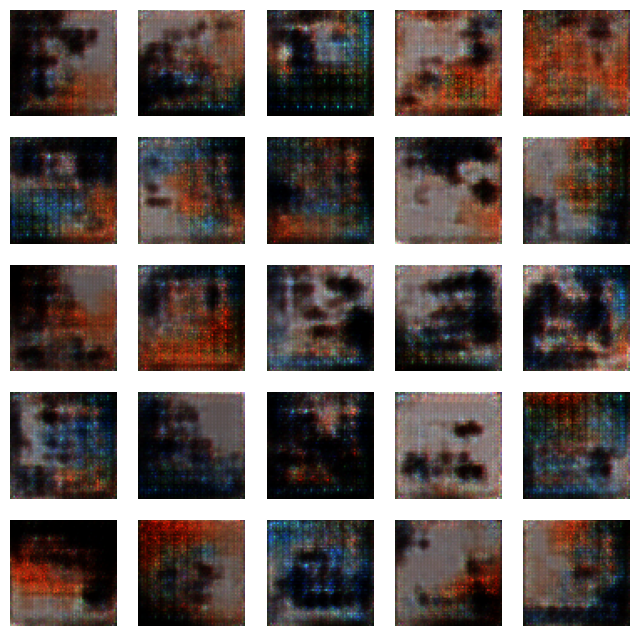

277/277 [==============================] - 20s 71ms/step - d_loss: 0.7263 - g_loss: 0.7410
Epoch 29/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7273 - g_loss: 0.7284

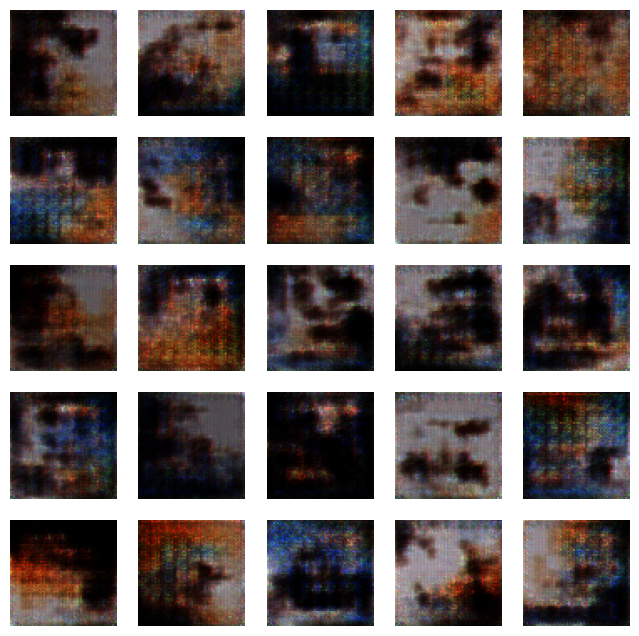

277/277 [==============================] - 20s 73ms/step - d_loss: 0.7273 - g_loss: 0.7284
Epoch 30/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7226 - g_loss: 0.7141

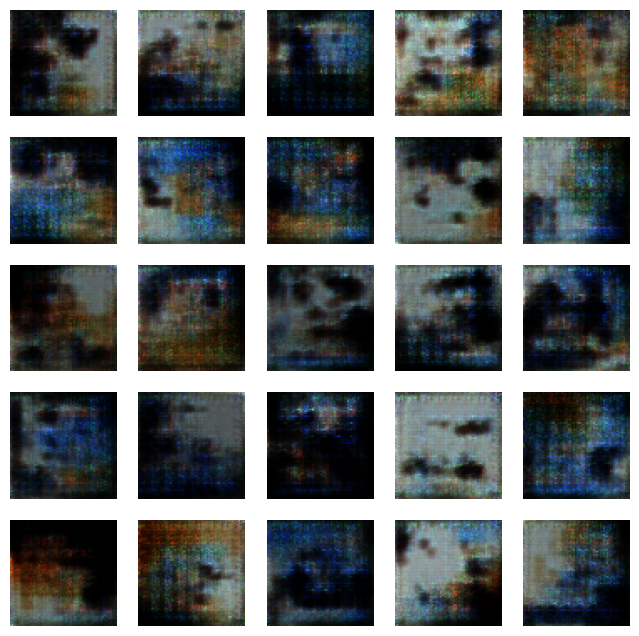

277/277 [==============================] - 20s 72ms/step - d_loss: 0.7226 - g_loss: 0.7141
Epoch 31/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7207 - g_loss: 0.7163

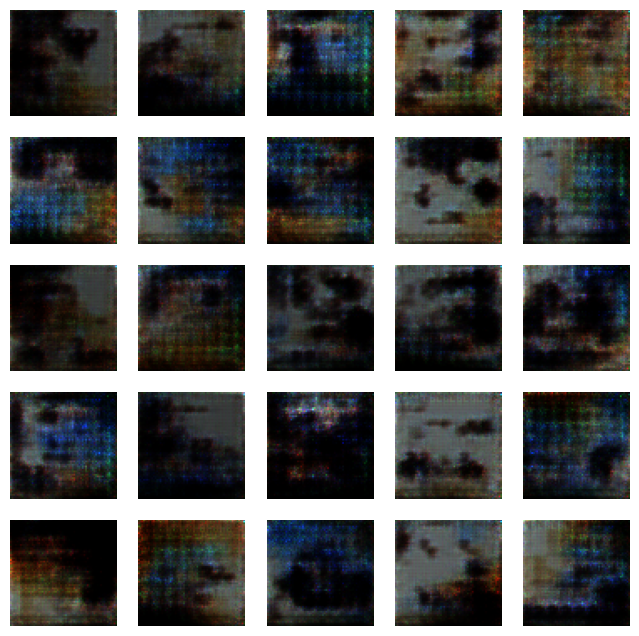

277/277 [==============================] - 20s 71ms/step - d_loss: 0.7207 - g_loss: 0.7163
Epoch 32/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7170 - g_loss: 0.7187

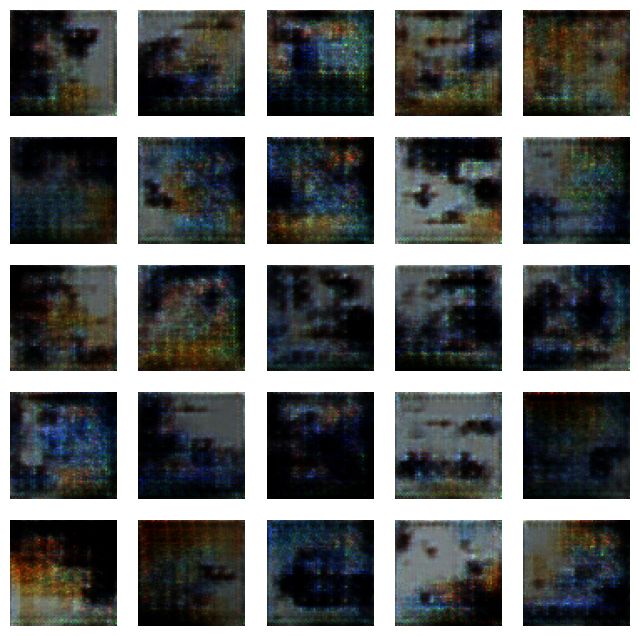

277/277 [==============================] - 20s 72ms/step - d_loss: 0.7170 - g_loss: 0.7187
Epoch 33/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7119 - g_loss: 0.7252

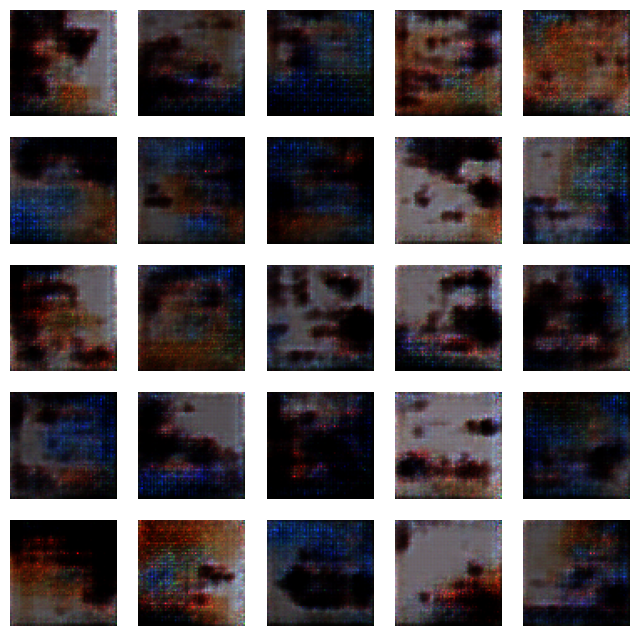

277/277 [==============================] - 20s 72ms/step - d_loss: 0.7119 - g_loss: 0.7252
Epoch 34/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7135 - g_loss: 0.7118

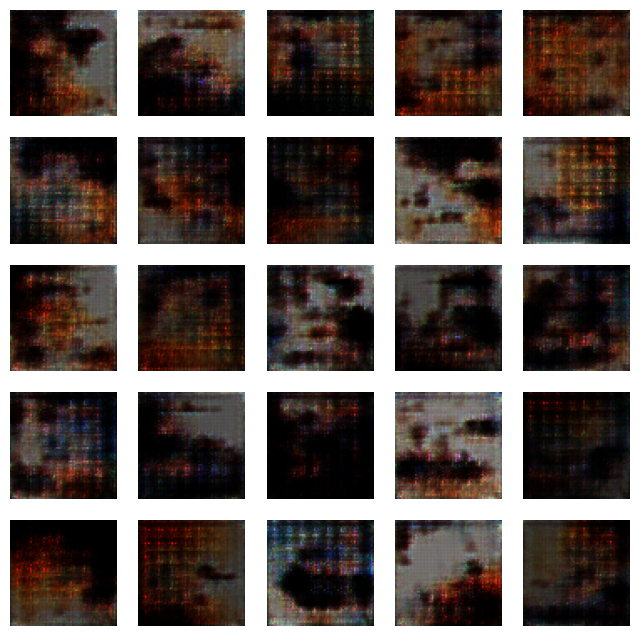

277/277 [==============================] - 20s 71ms/step - d_loss: 0.7135 - g_loss: 0.7118
Epoch 35/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7137 - g_loss: 0.7023

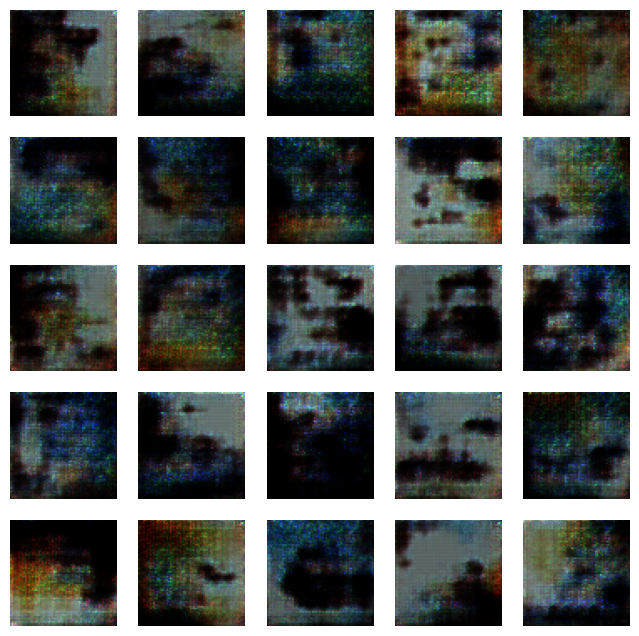

277/277 [==============================] - 20s 73ms/step - d_loss: 0.7137 - g_loss: 0.7023
Epoch 36/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7096 - g_loss: 0.7226

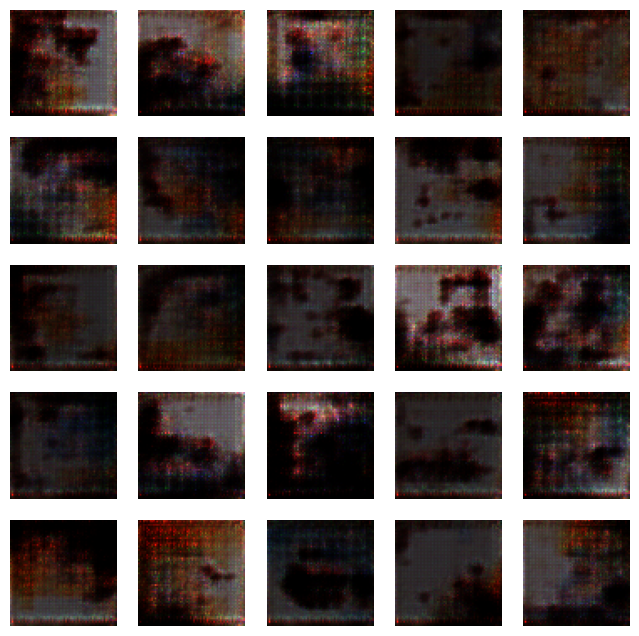

277/277 [==============================] - 20s 72ms/step - d_loss: 0.7096 - g_loss: 0.7226
Epoch 37/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7131 - g_loss: 0.7153

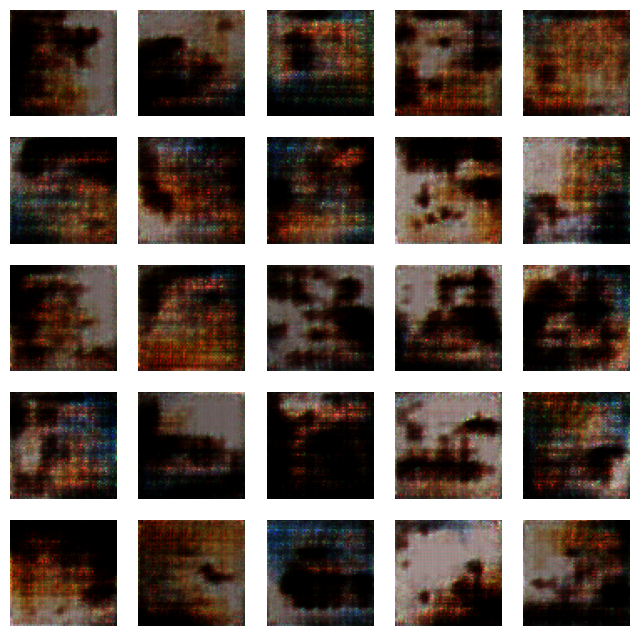

277/277 [==============================] - 20s 71ms/step - d_loss: 0.7131 - g_loss: 0.7153
Epoch 38/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7072 - g_loss: 0.7022

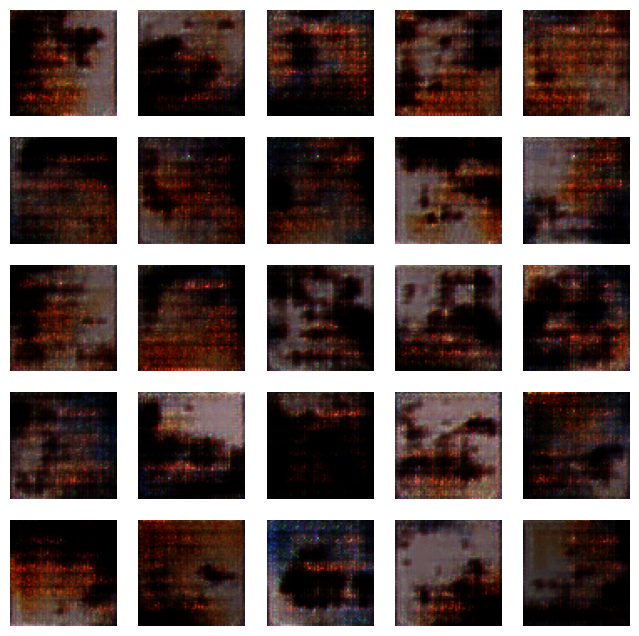

277/277 [==============================] - 20s 71ms/step - d_loss: 0.7072 - g_loss: 0.7022
Epoch 39/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7062 - g_loss: 0.7117

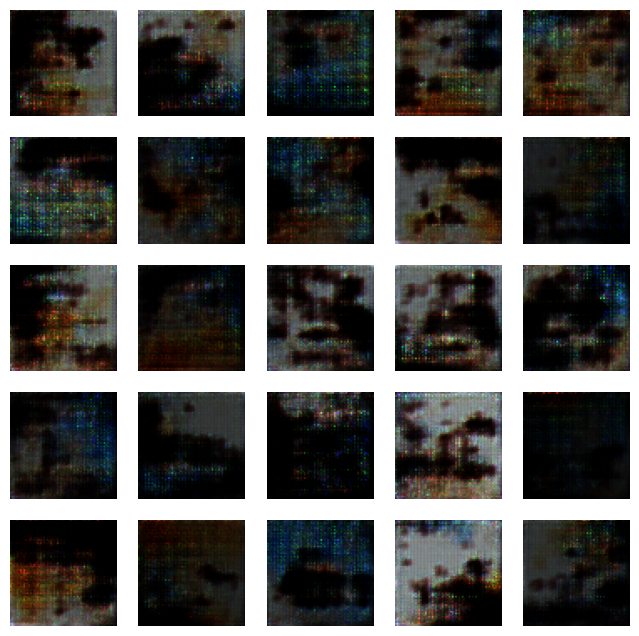

277/277 [==============================] - 20s 73ms/step - d_loss: 0.7062 - g_loss: 0.7117
Epoch 40/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7029 - g_loss: 0.7299

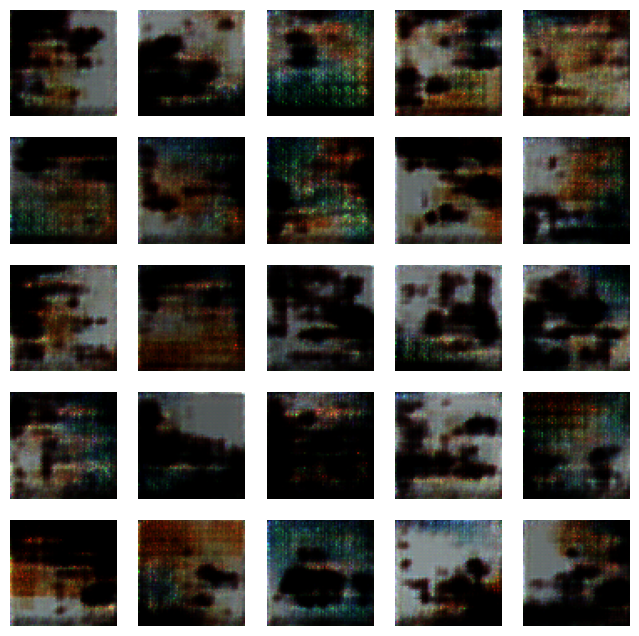

277/277 [==============================] - 20s 71ms/step - d_loss: 0.7029 - g_loss: 0.7299
Epoch 41/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7036 - g_loss: 0.7133

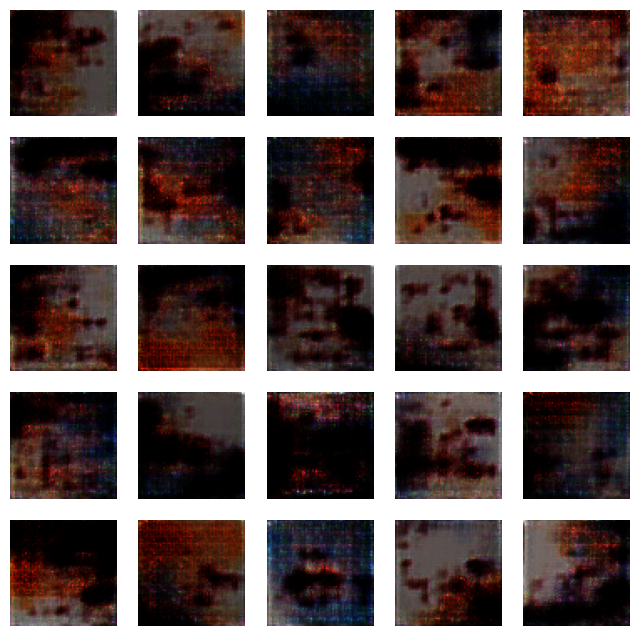

277/277 [==============================] - 20s 71ms/step - d_loss: 0.7036 - g_loss: 0.7133
Epoch 42/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7026 - g_loss: 0.7114

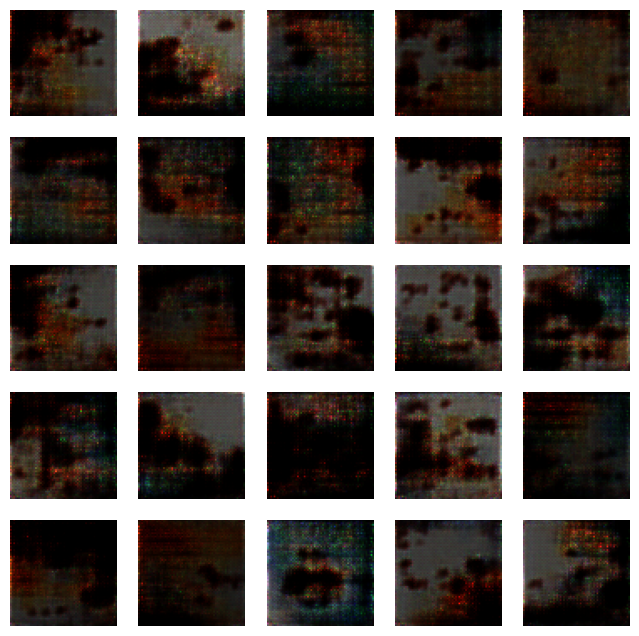

277/277 [==============================] - 20s 73ms/step - d_loss: 0.7026 - g_loss: 0.7114
Epoch 43/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7015 - g_loss: 0.7063

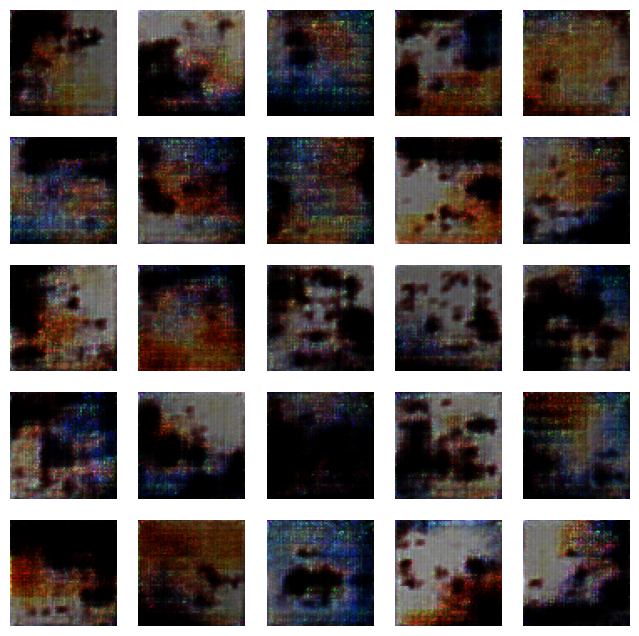

277/277 [==============================] - 20s 71ms/step - d_loss: 0.7015 - g_loss: 0.7063
Epoch 44/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7025 - g_loss: 0.7086

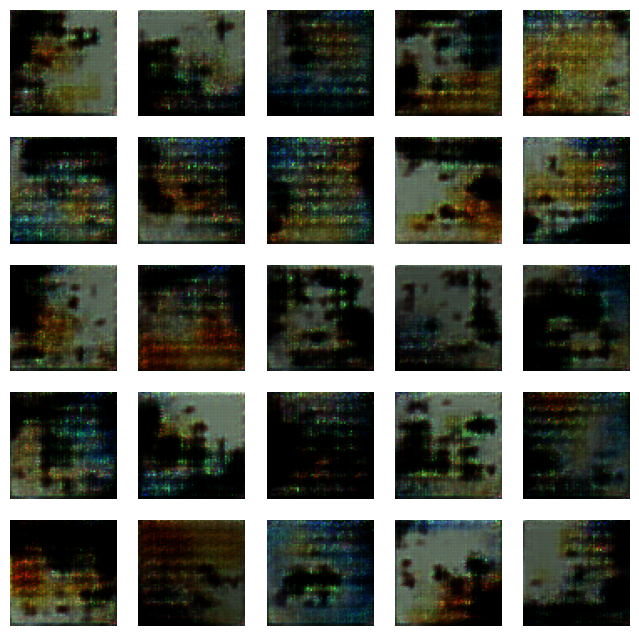

277/277 [==============================] - 20s 71ms/step - d_loss: 0.7025 - g_loss: 0.7086
Epoch 45/60
277/277 [==============================] - ETA: 0s - d_loss: 0.6872 - g_loss: 0.8130

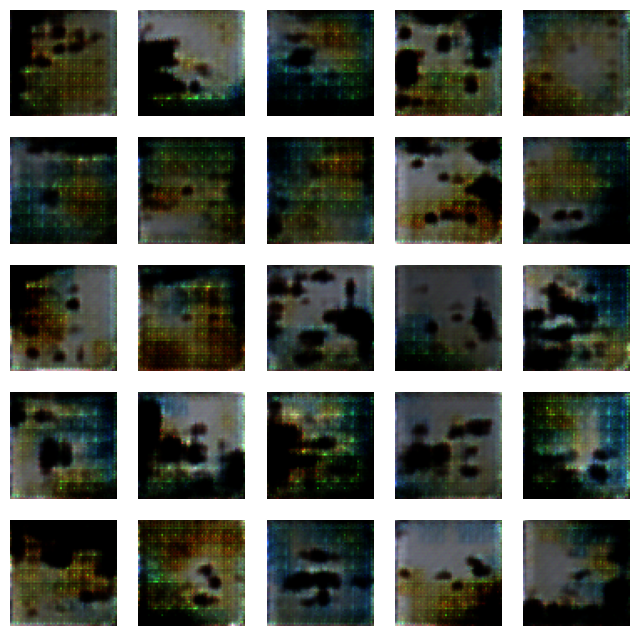

277/277 [==============================] - 20s 73ms/step - d_loss: 0.6872 - g_loss: 0.8130
Epoch 46/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7012 - g_loss: 0.7206

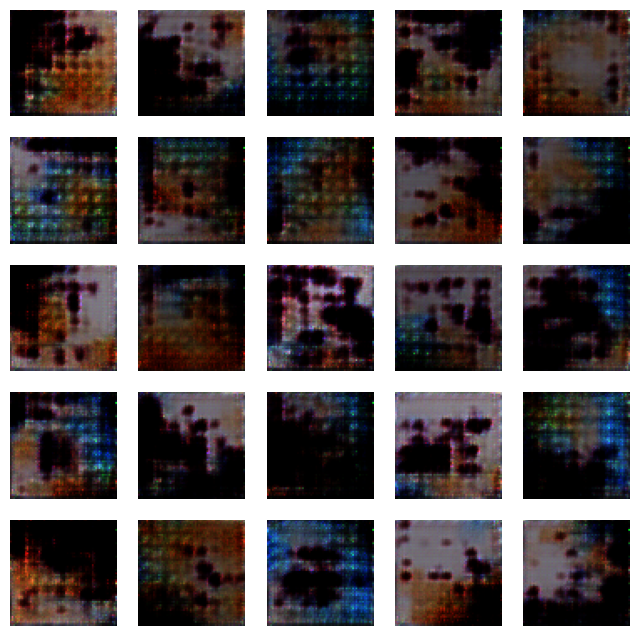

277/277 [==============================] - 20s 72ms/step - d_loss: 0.7012 - g_loss: 0.7206
Epoch 47/60
277/277 [==============================] - ETA: 0s - d_loss: 0.7003 - g_loss: 0.7204

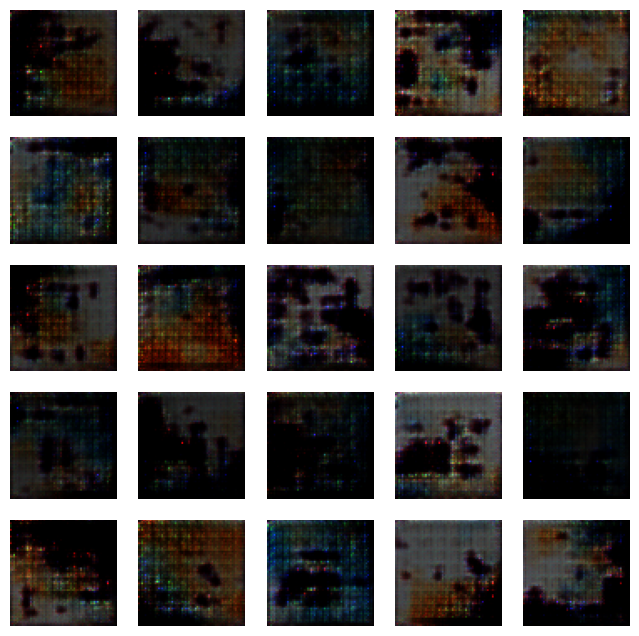

277/277 [==============================] - 20s 71ms/step - d_loss: 0.7003 - g_loss: 0.7204
Epoch 48/60
277/277 [==============================] - ETA: 0s - d_loss: 0.6987 - g_loss: 0.7198

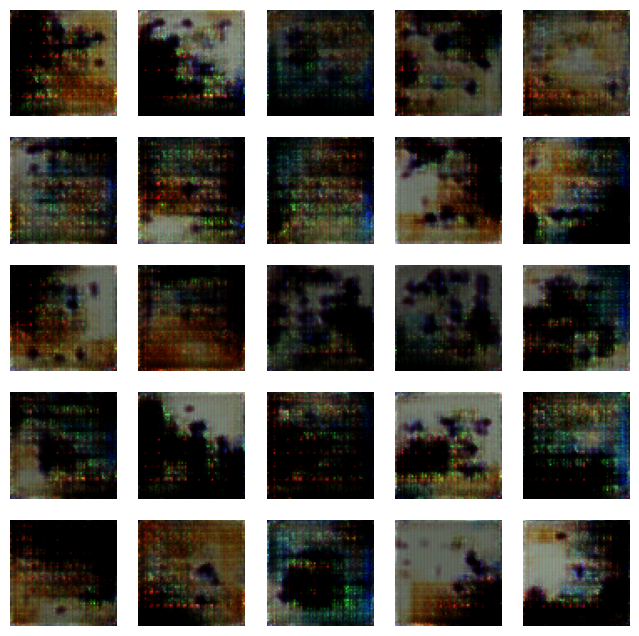

277/277 [==============================] - 20s 73ms/step - d_loss: 0.6987 - g_loss: 0.7198
Epoch 49/60
277/277 [==============================] - ETA: 0s - d_loss: 0.6946 - g_loss: 0.7302

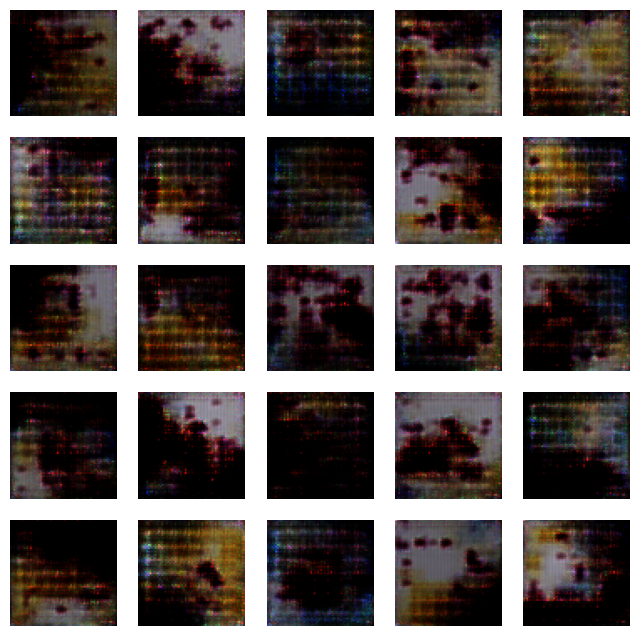

277/277 [==============================] - 20s 72ms/step - d_loss: 0.6946 - g_loss: 0.7302
Epoch 50/60
277/277 [==============================] - ETA: 0s - d_loss: 0.6968 - g_loss: 0.7186

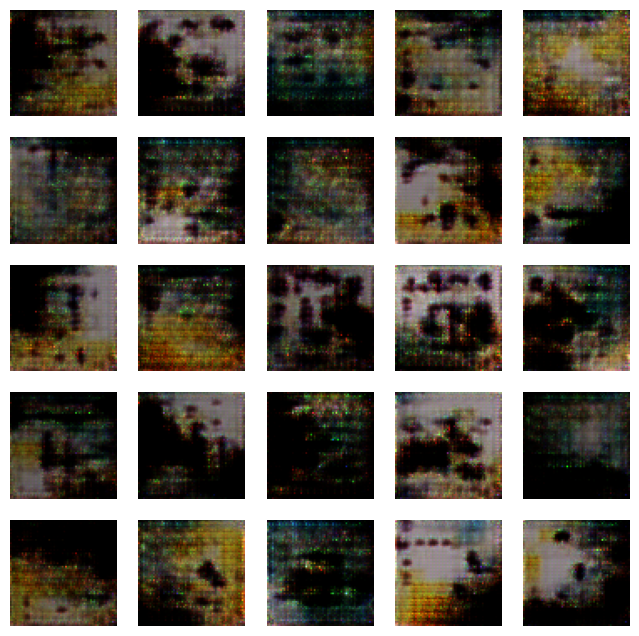

277/277 [==============================] - 20s 71ms/step - d_loss: 0.6968 - g_loss: 0.7186
Epoch 51/60
277/277 [==============================] - ETA: 0s - d_loss: 0.6986 - g_loss: 0.7167

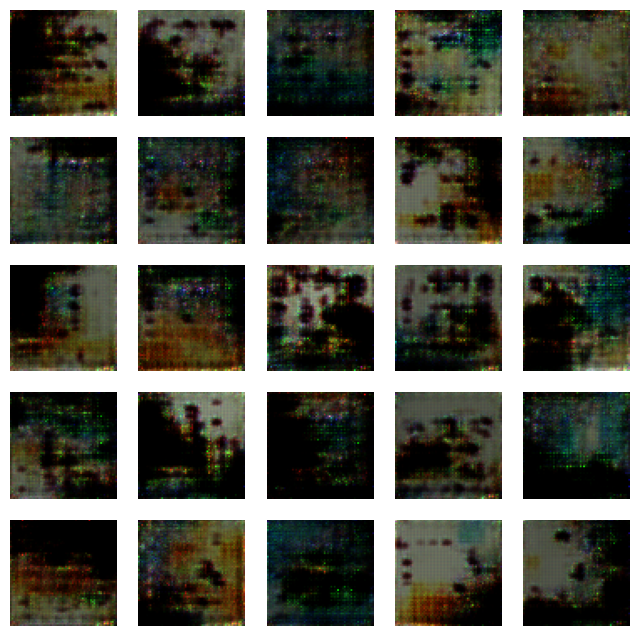

277/277 [==============================] - 20s 72ms/step - d_loss: 0.6986 - g_loss: 0.7167
Epoch 52/60
277/277 [==============================] - ETA: 0s - d_loss: 0.6970 - g_loss: 0.7148

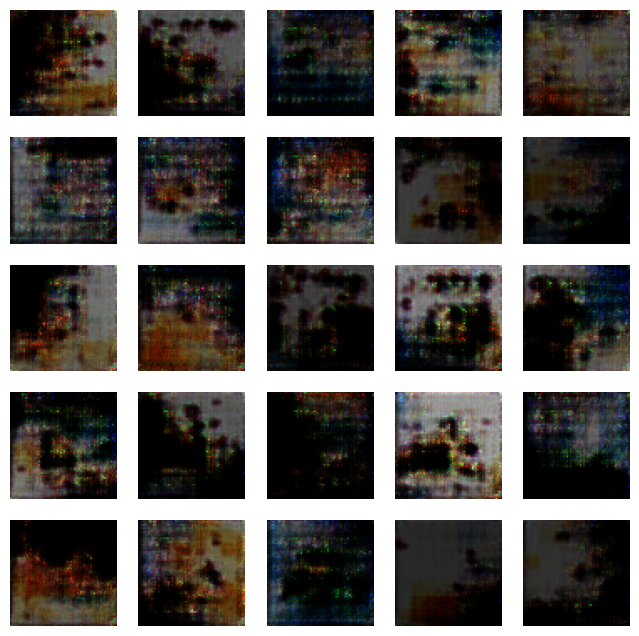

277/277 [==============================] - 20s 72ms/step - d_loss: 0.6970 - g_loss: 0.7148
Epoch 53/60
277/277 [==============================] - ETA: 0s - d_loss: 0.6942 - g_loss: 0.7203

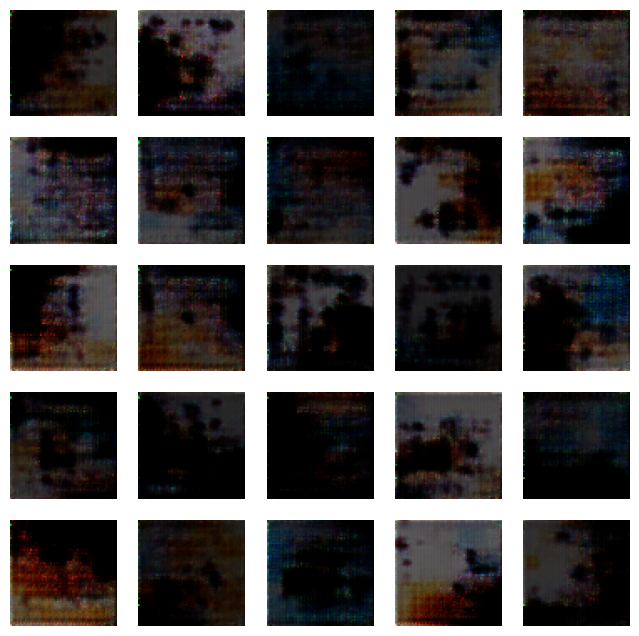

277/277 [==============================] - 20s 71ms/step - d_loss: 0.6942 - g_loss: 0.7203
Epoch 54/60
277/277 [==============================] - ETA: 0s - d_loss: 0.6919 - g_loss: 0.7258

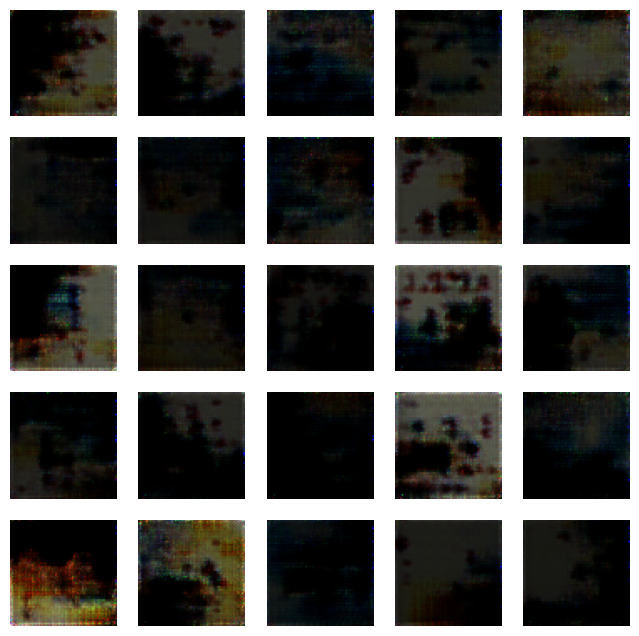

277/277 [==============================] - 20s 73ms/step - d_loss: 0.6919 - g_loss: 0.7258
Epoch 55/60
277/277 [==============================] - ETA: 0s - d_loss: 0.6924 - g_loss: 0.7240

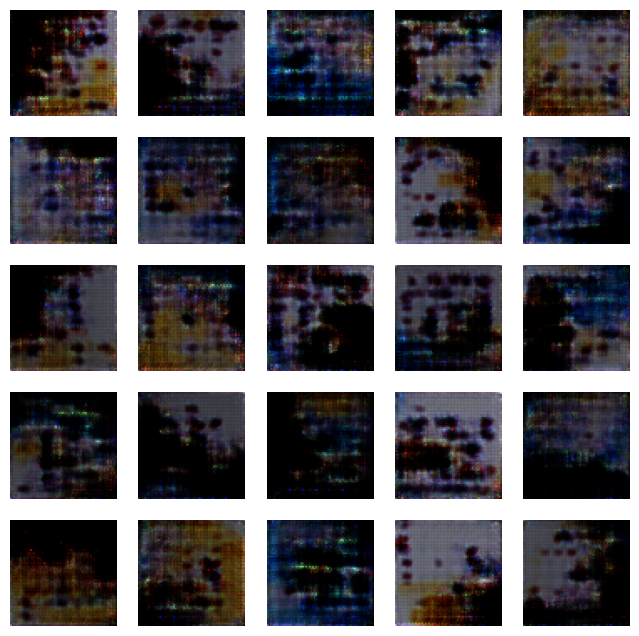

277/277 [==============================] - 20s 71ms/step - d_loss: 0.6924 - g_loss: 0.7240
Epoch 56/60
277/277 [==============================] - ETA: 0s - d_loss: 0.6885 - g_loss: 0.7325

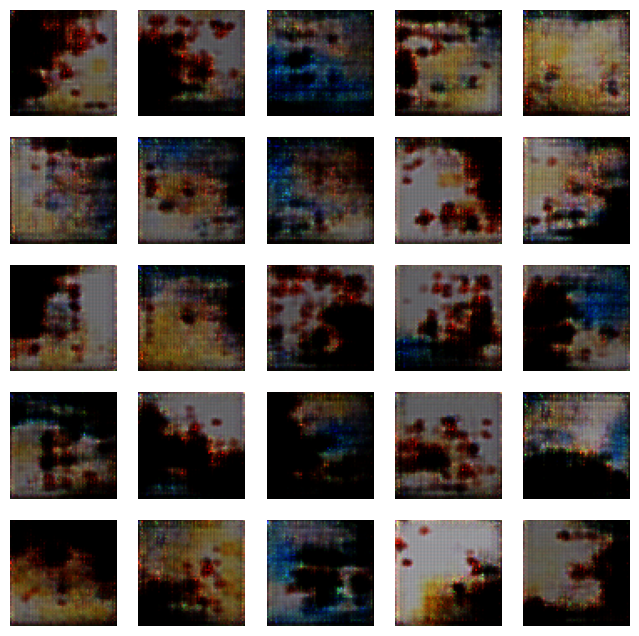

277/277 [==============================] - 20s 71ms/step - d_loss: 0.6885 - g_loss: 0.7325
Epoch 57/60
277/277 [==============================] - ETA: 0s - d_loss: 0.6879 - g_loss: 0.7336

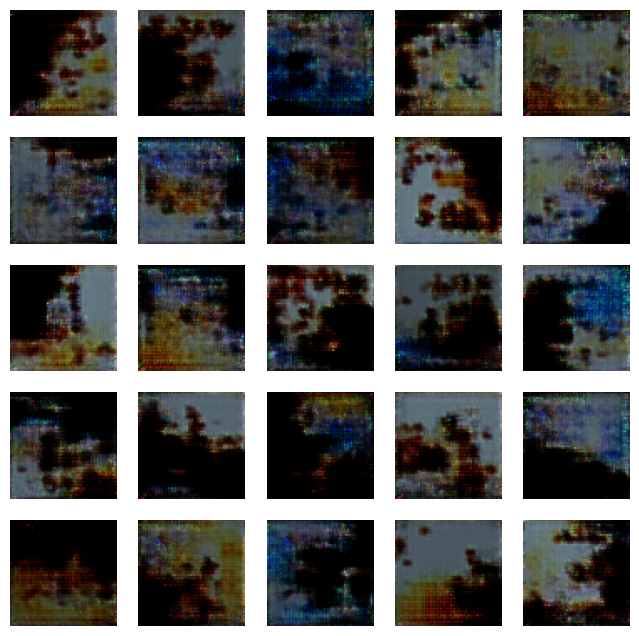

277/277 [==============================] - 20s 74ms/step - d_loss: 0.6879 - g_loss: 0.7336
Epoch 58/60
 69/277 [======>.......................] - ETA: 13s - d_loss: 0.6907 - g_loss: 0.7504

In [ ]:
N_EPOCHS = 60
dcgan.fit(train_images, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])

In [ ]:
# Generate creative and unpredictable output
print_search(prompt, temperature=0.9)

# Generate diverse output
print_search(prompt, top_p=0.9)

# Generate longer output
print_search(prompt, n=500)

In [ ]:
# dcgan.fit(train_images, epochs=40, callbacks=[DCGANMonitor()])

## Generate New Image

In [ ]:
noise = tf.random.normal([1, 100])
fig = plt.figure(figsize=(3, 3))
# generate the image from noise
g_img = dcgan.generator(noise)
# denormalize the image
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
plt.savefig('save.png')
plt.show()

In [ ]:
import cv2

# Load the generated image
image = cv2.imread('save.png')

# Resize the image to 224x224
resized_image = cv2.resize(image, (300, 427))

# Save the resized image
cv2.imwrite('resized_generated_image.png', resized_image)

In [ ]:
resized_image

In [ ]:
model.generator.save('generator.h5')

In [ ]:
# Import the necessary libraries
import torch
import torch.nn as nn
import torch.optim as optim
from tensorflow.keras.preprocessing.image import load_img

# Define the discriminator network
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        # Define the network architecture
        self.model = nn.Sequential(
            nn.Linear(784, 256),
            nn.LeakyReLU(0.2),
            nn.Linear(256, 1),
            nn.Sigmoid()
        )

    def forward(self, x):
        # Forward pass
        return self.model(x)

# Define the generator network
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        # Define the network architecture
        self.model = nn.Sequential(
            nn.Linear(100, 256),
            nn.LeakyReLU(0.2),
            nn.Linear(256, 784),
            nn.Tanh()
        )

    def forward(self, x):
        # Forward pass
        return self.model(x)

# Load the training data
train_data = torch.utils.data.DataLoader(
      # load the image and convert to numpy array
    train_images = [np.array(load_img(path).resize((64, 64))) for path in tqdm(image_paths)]
    train_images = np.array(train_images)
)

class BCELoss(nn.Module):
    def __init__(self):
        super(BCELoss, self).__init__()
        self.loss = nn.BCELoss()

    def forward(self, y_pred, y_true):
        # Flatten the input tensors
        y_pred = y_pred.view(-1)
        y_true = y_true.view(-1)

        # Calculate the binary cross-entropy loss
        loss = self.loss(y_pred, y_true)

        return loss

# Create a BCELoss instance
loss_function = BCELoss()

# Generate some random data
y_pred = torch.rand(100)
y_true = torch.randint(0, 2, (100,))

# Calculate the loss
loss = loss_function(y_pred, y_true)

# Print the loss
print(loss)